# Automatic detection of malignant tumors in the lungs using Computed Tomographies (CT scans)'

This is an updated and debugged implementation of the book "Deep Learning with PyTorch" (Eli Stevens, Luca Antiga, and Thomas Viehmann). https://github.com/deep-learning-with-pytorch/dlwpt-code/tree/master

Download data (110 GB when uncompressed): https://luna16.grand-challenge.org/

After caching data and preprocess it, we got the LunaDataset in a format that PyTorch understands:

In [ ]:
#check your available cpu threads for num-workers
#torch.get_num_threads()

#Prepare cache
from lung_cancer_detection.cache.prepcache import LunaPrepCacheApp
# Instantiate and run
cache_app = LunaPrepCacheApp(['--batch-size', '512','--num-workers', '16'])
cache_app.main()

2025-10-17 18:47:25,368 INFO     pid:30291 lung_cancer_detection.cache.prepcache:036:main Starting LunaPrepCacheApp, Namespace(batch_size=512, num_workers=16)
2025-10-17 18:47:34,028 INFO     pid:30291 lung_cancer_detection.data.dsets:278:__init__ <lung_cancer_detection.data.dsets.LunaDataset object at 0x76d7fe000510>: 550896 training samples, 549714 neg, 1182 pos, unbalanced ratio
2025-10-17 18:47:34,029 WARNING  pid:30291 lung_cancer_detection.utils.util:219:enumerateWithEstimate Stuffing cache ----/1076, starting
2025-10-17 18:49:22,018 INFO     pid:30291 lung_cancer_detection.utils.util:236:enumerateWithEstimate Stuffing cache   64/1076, done at 2025-10-17 19:17:46, 0:29:46
2025-10-17 18:53:22,926 INFO     pid:30291 lung_cancer_detection.utils.util:236:enumerateWithEstimate Stuffing cache  256/1076, done at 2025-10-17 19:11:42, 0:23:42
2025-10-17 19:09:54,230 INFO     pid:30291 lung_cancer_detection.utils.util:236:enumerateWithEstimate Stuffing cache 1024/1076, done at 2025-10-17 1

In [ ]:
from lung_cancer_detection.data.classification_dsets import LunaDataset

LunaDataset()[0]

2025-10-21 01:22:46,506 INFO     pid:4801 lung_cancer_detection.data.analysis_dsets:278:__init__ <lung_cancer_detection.data.analysis_dsets.LunaDataset object at 0x78c98ddf5810>: 550896 training samples, 549714 neg, 1182 pos, unbalanced ratio


(tensor([[[[ -180.,   164.,   271.,  ...,   148.,   207.,   -17.],
           [   13.,    41.,  -223.,  ...,     0.,    67.,   127.],
           [   10.,  -144.,   138.,  ...,     7.,    56.,   -24.],
           ...,
           [ -967., -1000.,  -905.,  ...,  -893.,  -330.,  -142.],
           [ -839.,  -732.,  -873.,  ...,  -293.,   123.,  -495.],
           [ -643.,  -518.,  -523.,  ...,     0.,   -28.,   -21.]],
 
          [[ -125.,   209.,   289.,  ...,   336.,    27.,   -70.],
           [  180.,    -6.,  -134.,  ...,  -113.,   -45.,    32.],
           [    2.,   163.,   -86.,  ...,   169.,   323.,  -106.],
           ...,
           [-1000., -1000.,  -916.,  ...,  -976.,  -685.,  -172.],
           [ -897., -1000.,  -878.,  ...,  -456.,  -142.,  -328.],
           [ -624.,  -786.,  -908.,  ...,    20.,    50.,  -121.]],
 
          [[  -15.,  -137.,   220.,  ...,  -112.,   197.,   -91.],
           [  228.,   286.,   -88.,  ...,  -280.,   231.,   206.],
           [    9.,    -

## Inference

In this notebook we are just running the final model for inference, the training and validation will be inside the training directory of this project.

In [1]:
from lung_cancer_detection.nodule_analysis import NoduleAnalysisApp

In [2]:
nodule_analysis = NoduleAnalysisApp(['--batch-size','32','--num-workers','8','1.3.6.1.4.1.14519.5.2.1.6279.6001.592821488053137951302246128864'])
nodule_analysis.main()

2025-10-21 01:27:39,302 DEBUG    pid:8781 lung_cancer_detection.nodule_analysis:213:initModels data/part2/models/seg_2020-01-26_19.45.12_w4d3c1-bal_1_nodupe-label_pos-d1_fn8-adam.best.state
2025-10-21 01:27:39,621 DEBUG    pid:8781 lung_cancer_detection.nodule_analysis:229:initModels data/part2/models/cls_2020-02-06_14.16.55_final-nodule-nonnodule.best.state
2025-10-21 01:27:39,689 INFO     pid:8781 lung_cancer_detection.nodule_analysis:289:main Starting NoduleAnalysisApp, Namespace(batch_size=32, num_workers=8, run_validation=False, include_train=False, segmentation_path='data/part2/models/seg_2020-01-26_19.45.12_w4d3c1-bal_1_nodupe-label_pos-d1_fn8-adam.best.state', cls_model='LunaModel', classification_path='data/part2/models/cls_2020-02-06_14.16.55_final-nodule-nonnodule.best.state', malignancy_model='LunaModel', malignancy_path=None, tb_prefix='p2ch14', series_uid='1.3.6.1.4.1.14519.5.2.1.6279.6001.592821488053137951302246128864')
2025-10-21 01:27:47,847 WARNING  pid:8781 lung_can

found nodule candidates in 1.3.6.1.4.1.14519.5.2.1.6279.6001.592821488053137951302246128864:
nodule prob 0.532, center xyz XyzTuple(x=np.float64(-128.857421875), y=np.float64(-80.349609375), z=np.float64(-31.300007820129395))
nodule prob 0.753, center xyz XyzTuple(x=np.float64(-116.396484375), y=np.float64(-168.142578125), z=np.float64(-238.30000233650208))
nodule prob 0.538, center xyz XyzTuple(x=np.float64(-106.767578125), y=np.float64(-185.701171875), z=np.float64(-241.90000224113464))
nodule prob 0.995, center xyz XyzTuple(x=np.float64(-94.306640625), y=np.float64(-147.751953125), z=np.float64(-123.10000538825989))
nodule prob 0.834, center xyz XyzTuple(x=np.float64(-92.607421875), y=np.float64(-147.751953125), z=np.float64(-121.3000054359436))
nodule prob 0.856, center xyz XyzTuple(x=np.float64(-68.818359375), y=np.float64(-122.830078125), z=np.float64(-101.50000596046448))
nodule prob 0.745, center xyz XyzTuple(x=np.float64(-21.806640625), y=np.float64(-91.111328125), z=np.float6

In [1]:
%matplotlib inline
import copy
import numpy as np
import matplotlib.pyplot as plt

In [3]:
import torch
from lung_cancer_detection.data.segmentation_dsets import getCandidateInfoList, getCt #, old_build2dLungMask
from lung_cancer_detection.models.segmentation_model import SegmentationMask, MaskTuple
from lung_cancer_detection.visualizations.seg_vis import build2dLungMask
from lung_cancer_detection.utils.util import xyz2irc


candidateInfo_list = getCandidateInfoList(requireOnDisk_bool=False)
candidateInfo_list[0]

CandidateInfoTuple(isNodule_bool=True, hasAnnotation_bool=True, isMal_bool=True, diameter_mm=32.27003025, series_uid='1.3.6.1.4.1.14519.5.2.1.6279.6001.287966244644280690737019247886', center_xyz=(67.82725575, 85.37992457, -109.74672379999998))

In [4]:
series_list = sorted(set(t.series_uid for t in candidateInfo_list))

In [5]:
def transparent_cmap(cmap, N=255):
    "Copy colormap and set alpha values"

    mycmap = copy.deepcopy(cmap)
    mycmap._init()
    mycmap._lut[:,-1] = np.linspace(0, 0.75, N+4)
    return mycmap
tgray = transparent_cmap(plt.cm.gray)
tpurp = transparent_cmap(plt.cm.Purples)
tblue = transparent_cmap(plt.cm.Blues)
tgreen = transparent_cmap(plt.cm.Greens)
torange = transparent_cmap(plt.cm.Oranges)
tred = transparent_cmap(plt.cm.Reds)


clim=(0, 1.3)
start_ndx = 3
mask_model = SegmentationMask().to('cuda')

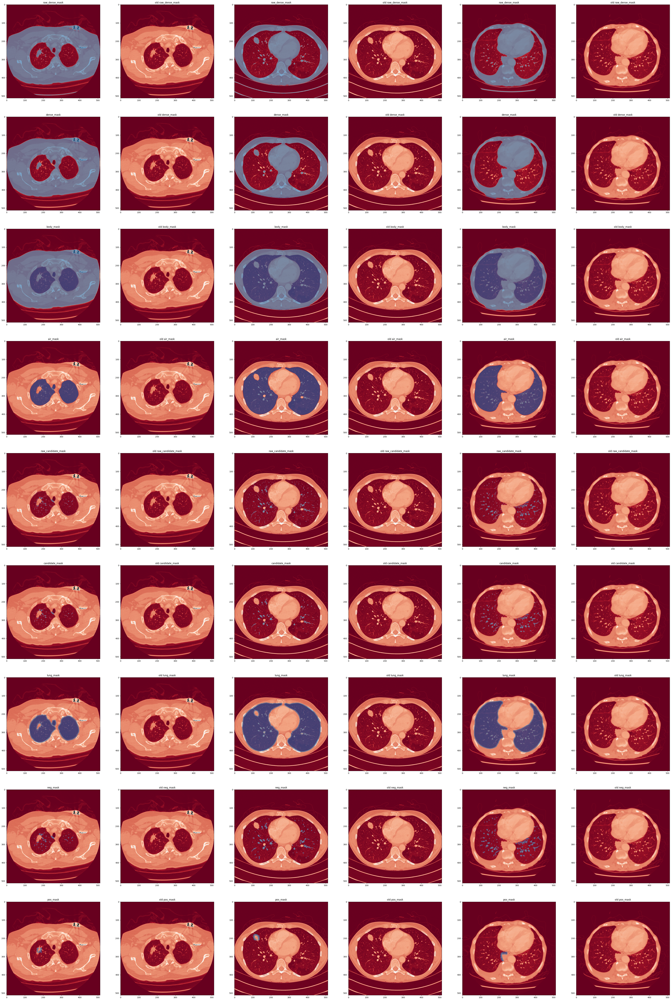

In [8]:
ct_list = []
for nit_ndx in range(start_ndx, start_ndx+3):
    candidateInfo_tup = candidateInfo_list[nit_ndx]
    ct = getCt(candidateInfo_tup.series_uid)
    center_irc = xyz2irc(candidateInfo_tup.center_xyz, ct.origin_xyz, ct.vxSize_xyz, ct.direction_a)
    
    ct_list.append((ct, center_irc))
start_ndx = nit_ndx + 1

fig = plt.figure(figsize=(60,90))
subplot_ndx = 0 
for ct_ndx, (ct, center_irc) in enumerate(ct_list):
    mask_tup = build2dLungMask(ct.series_uid, int(center_irc.index))
    #old_tup = old_build2dLungMask(ct.series_uid, int(center_irc.index))
    
#    ct_g = torch.from_numpy(ct.hu_a[int(center_irc.index)].astype(np.float32)).unsqueeze(0).unsqueeze(0).to('cuda')
#    pos_g = torch.from_numpy(ct.positive_mask[int(center_irc.index)].astype(np.float32)).unsqueeze(0).unsqueeze(0).to('cuda')
#    input_g = ct_g / 1000
    
#    label_g, neg_g, pos_g, lung_mask, mask_dict = mask_model(input_g, pos_g)
#    mask_tup = MaskTuple(**mask_dict)
    for attr_ndx, attr_str in enumerate(mask_tup._fields):

        subplot_ndx = 1 + 3 * 2 * attr_ndx + 2 * ct_ndx
        subplot = fig.add_subplot(len(mask_tup), len(ct_list)*2, subplot_ndx)
        subplot.set_title(attr_str)
        
        
        #print(layer_func, ct.hu_a.shape, layer_func(ct, mask_tup, int(center_irc.index)).shape, center_irc.index)

        plt.imshow(ct.hu_a[int(center_irc.index)], clim=(-1000, 3000), cmap='RdGy')
        plt.imshow(mask_tup[attr_ndx][0][0].cpu(), clim=clim, cmap=tblue)

        subplot = fig.add_subplot(len(mask_tup), len(ct_list)*2, subplot_ndx+1)
        subplot.set_title('old '+ attr_str)

        plt.imshow(ct.hu_a[int(center_irc.index)], clim=(-1000, 3000), cmap='RdGy')
        #plt.imshow(old_tup[attr_ndx], clim=clim, cmap=tblue)
        
        #if attr_ndx == 1: break
    #break